<h1><span style="font-size: 24px; font-family: Candara, Lato, Arial, Verdana;">Parkinson's disease Classification - Ensemble Techniques Project</span></h1>

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">Objective:</span></strong>
</p>
<p><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">The goal of this binary classification task is to predict the patients as having parkinson's disease or not based on voice recording data to act as an effective screening step for doctors to consider a patient for further diagnostics by a clinician.</strong>.</span>
</p>

<p><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 17px;"><strong>Executive Summary:</strong></span></p>

<p><span style="font-family: Candara, Lato, Arial, Verdana;">&nbsp; <span style="font-size: 17px;">Parkinson's disease is a brain disorder that leads to shaking, stiffness, and difficulty with walking, balance, and coordination. There is commonly a marked effect on speech, including dysarthria (difficulty articulating sounds), hypophonia (lowered volume), and monotone (reduced pitch range). Additionally, cognitive impairments and changes in mood can occur, and risk of dementia is increased. So, we aim to use the voice recording data of a patient to predict a patient having Parkinson's disease, it would act as an effective, non invasive screening step before requiring a clinic visit to test those at-risk patients and diagnose them.<br>The dataset was created by Max Little of the University of Oxford, in &nbsp;collaboration with the National Centre for Voice and Speech, Denver, &nbsp;Colorado, who recorded the speech signals. It is composed of a range of biomedical voice measurements from &nbsp;31 people, 23 with Parkinson&apos;s disease (PD). Each column in the table is a particular voice measure, and each row corresponds one of 195 voice recording from these individuals (&quot;name&quot; column). The main aim of the data &nbsp;is to discriminate healthy people from those with PD, according to &quot;status&quot; column which is set to 0 for healthy and 1 for PD.</span></span></p>

In [1]:
# install additional required libs
# !pip install pandas-profiling
# !pip install imblearn
# !pip install xgboost
# !pip install catboost
# !pip install lightgbm

# (or to install conda packages with anaconda or miniconda)

#!conda install -c conda-forge pandas-profiling
# !conda install -c conda-forge imbalanced-learn
# !conda install -c conda-forge xgboost
# !conda install -c conda-forge catboost
# !conda install -c conda-forge lightgbm

In [2]:
import os, time
import platform, warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
sns.set_style(style= 'darkgrid')
%matplotlib inline

# warnings.filterwarnings('ignore')
print(f'Py: {platform.python_version()}')

Py: 3.8.5


<p><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 17px;">We go through the machine learning <strong>pipeline</strong>, starting with reading the dataset and exploring the data through plots and summaries.&nbsp;</span><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;">Then, we move to preprocess the data to standardize the data and check for any missing values. Later, we build models to classify the data.&nbsp;</span></span>
</p>
<p><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 17px;">Finally, we evaluate the best models using the whole test dataset.</span>
</p>

In [3]:
# read in the dataset
dataset_path = './Data - Parkinsons.csv'
if not os.path.exists(dataset_path):
    raise FileNotFoundError(f'File not found at {dataset_path}')
df = pd.read_csv(dataset_path)
df.sample(7)

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
153,phon_R01_S37_1,121.345,139.644,98.250,0.00684,0.00006,0.00388,0.00332,0.01164,0.02534,...,0.04019,0.04179,21.520,1,0.566867,0.670475,-4.865194,0.246404,2.013530,0.168581
97,phon_R01_S24_1,125.036,143.946,116.187,0.01280,0.00010,0.00743,0.00623,0.02228,0.03886,...,0.06406,0.08151,15.338,1,0.629574,0.714485,-4.020042,0.265315,2.671825,0.340623
13,phon_R01_S04_2,139.173,179.139,76.556,0.00390,0.00003,0.00165,0.00208,0.00496,0.01642,...,0.02184,0.01041,24.889,1,0.430166,0.665833,-5.660217,0.254989,2.519422,0.199889
96,phon_R01_S22_6,159.116,168.913,144.811,0.00342,0.00002,0.00178,0.00184,0.00535,0.03381,...,0.05417,0.00852,22.663,1,0.366329,0.693429,-6.417440,0.194627,2.473239,0.151709
40,phon_R01_S08_5,186.163,197.724,177.584,0.00298,0.00002,0.00165,0.00175,0.00496,0.01495,...,0.02321,0.00231,26.822,1,0.326480,0.765623,-6.647379,0.201095,2.374073,0.130554
28,phon_R01_S06_5,155.358,227.383,80.055,0.00310,0.00002,0.00159,0.00176,0.00476,0.01718,...,0.02307,0.00677,25.970,1,0.470478,0.676258,-7.120925,0.279789,2.241742,0.108514


In [4]:
df.shape

(195, 24)

<p>    <span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;">Looking at the dataset from a data completeness perspective, it only has <strong>195 rows</strong>. This will likely lead to poor machine learning results. We have to have more data if we want our model to generalize well on out of sample data and our results or insights to be applicable in the real world. The variable <strong>name</strong> are all unique values and do not add any required information. So, we can remove this attribute for our modelling. Also, all the numerical values seem to have different ranges, So, we would have to <strong>scale the data</strong> before fitting models so that the variables with larger scales do not bias the model.<br>
    The target column is status (cateogical) and there seems to be an <strong>imbalance</strong> in the classes as there seem to be more positive examples (status = 1) than negative ones. So, we might need to employ certain <strong>upsampling techniques</strong> like SMOTE to balance the dataset. Overall, This is a binary classification problem, where the machine learning model will try to predict if each row is (status) 0 or 1.
    </span></span>
</p>

<p><strong><span style="font-size: 17px; font-family: Candara, Verdana, Geneva, sans-serif;">Challenges:</span></strong></p>
<ul>
    <li><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><span style="font-size: 17px;">We can see that the size of dataset is very small, so there many be more chances to over fit the data and the models we train might not be able to generalize well on out of sample data.</span></span></li>
    <li><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><span style="font-size: 17px;">The target column is not balanced which may affect the performance of the model.</span></span></li>
    <li><span style="font-size: 17px; font-family: Candara, Verdana, Geneva, sans-serif;">There are many input features, i.e, the curse of dimensionality where the number of features are high. So, We have to perform EDA and select the most optimal features required for the model.</span></li>
</ul>

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   name              195 non-null    object 
 1   MDVP:Fo(Hz)       195 non-null    float64
 2   MDVP:Fhi(Hz)      195 non-null    float64
 3   MDVP:Flo(Hz)      195 non-null    float64
 4   MDVP:Jitter(%)    195 non-null    float64
 5   MDVP:Jitter(Abs)  195 non-null    float64
 6   MDVP:RAP          195 non-null    float64
 7   MDVP:PPQ          195 non-null    float64
 8   Jitter:DDP        195 non-null    float64
 9   MDVP:Shimmer      195 non-null    float64
 10  MDVP:Shimmer(dB)  195 non-null    float64
 11  Shimmer:APQ3      195 non-null    float64
 12  Shimmer:APQ5      195 non-null    float64
 13  MDVP:APQ          195 non-null    float64
 14  Shimmer:DDA       195 non-null    float64
 15  NHR               195 non-null    float64
 16  HNR               195 non-null    float64
 1

In [6]:
# Since pandas assumed wrong types of status attribute
df = df.astype({"status":'category'})

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   name              195 non-null    object  
 1   MDVP:Fo(Hz)       195 non-null    float64 
 2   MDVP:Fhi(Hz)      195 non-null    float64 
 3   MDVP:Flo(Hz)      195 non-null    float64 
 4   MDVP:Jitter(%)    195 non-null    float64 
 5   MDVP:Jitter(Abs)  195 non-null    float64 
 6   MDVP:RAP          195 non-null    float64 
 7   MDVP:PPQ          195 non-null    float64 
 8   Jitter:DDP        195 non-null    float64 
 9   MDVP:Shimmer      195 non-null    float64 
 10  MDVP:Shimmer(dB)  195 non-null    float64 
 11  Shimmer:APQ3      195 non-null    float64 
 12  Shimmer:APQ5      195 non-null    float64 
 13  MDVP:APQ          195 non-null    float64 
 14  Shimmer:DDA       195 non-null    float64 
 15  NHR               195 non-null    float64 
 16  HNR               195 non-

<p><strong><span style="font-size: 16px; font-family: Candara, Verdana, Geneva, sans-serif;">Attribute Information:</span></strong></p>
<ul>
    <li><span style="font-size: 16px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><strong>name</strong> - ASCII subject name and recording number</span></span></li>
    <li><span style="font-size: 16px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><strong>MDVP:Fo(Hz)</strong> - Average vocal fundamental frequency</span></span></li>
    <li><span style="font-size: 16px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><strong>MDVP:Fhi(Hz)</strong> - Maximum vocal fundamental frequency</span></span></li>
    <li><span style="font-size: 16px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><strong>MDVP:Flo(Hz)</strong> - Minimum vocal fundamental frequency</span></span></li>
    <li><span style="font-size: 16px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><strong>MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP</strong> - Several&nbsp;</span></span><span style="font-size: 16px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;">measures of variation in fundamental frequency</span></span></li>
    <li><span style="font-size: 16px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><strong>MDVP:Shimmer,MDVP:Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,MDVP:APQ,Shimmer:DDA&nbsp;</strong>- Several measures of variation in amplitude</span></span></li>
    <li><span style="font-size: 16px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><strong>NHR,HNR</strong> - Two measures of ratio of noise to tonal components in the voice</span></span></li>
    <li><span style="font-size: 16px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><strong>status</strong> - Health status of the subject (one) - Parkinson&apos;s, (zero) - healthy</span></span></li>
    <li><span style="font-size: 16px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><strong>RPDE,D2</strong> - Two nonlinear dynamical complexity measures</span></span></li>
    <li><span style="font-size: 16px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><strong>DFA </strong>- Signal fractal scaling exponent</span></span></li>
    <li><span style="font-size: 16px; font-family: Candara, Verdana, Geneva, sans-serif;"><strong>spread1,spread2,PPE</strong> - Three nonlinear measures of fundamental frequency variation</span>&nbsp;</li>
</ul>

<ul>
	<li style="box-sizing: border-box; text-rendering: auto; margin-top: 0px; margin-right: 0px; margin-bottom: 16px; text-align: left; font-family: Inter, sans-serif; color: rgba(0, 0, 0, 0.7); font-size: 14px; line-height: 1.7; font-style: normal; font-variant-ligatures: normal; font-variant-caps: normal; font-weight: 400; letter-spacing: normal; text-indent: 0px; text-transform: none; white-space: normal; word-spacing: 0px; -webkit-text-stroke-width: 0px; text-decoration-style: initial; text-decoration-color: initial;"><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;">All variables are <strong>Numeric attributes</strong> excluding <strong>status</strong> which is our target categorical attribute and name which is irrelevant to our modelling task.</span></span>
<p><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"><br></span></span>
</p>

In [8]:
# checking for missing values
df.isna().sum()

name                0
MDVP:Fo(Hz)         0
MDVP:Fhi(Hz)        0
MDVP:Flo(Hz)        0
MDVP:Jitter(%)      0
MDVP:Jitter(Abs)    0
MDVP:RAP            0
MDVP:PPQ            0
Jitter:DDP          0
MDVP:Shimmer        0
MDVP:Shimmer(dB)    0
Shimmer:APQ3        0
Shimmer:APQ5        0
MDVP:APQ            0
Shimmer:DDA         0
NHR                 0
HNR                 0
status              0
RPDE                0
DFA                 0
spread1             0
spread2             0
D2                  0
PPE                 0
dtype: int64

<blockquote>
    <p><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;">We confirm that there are <strong>no missing values</strong>(NAs). Hence, we do not need to remove or impute missing<br>values. If there were missing values we do some value imputation using medians or maybe knn imputation based on the data points nearest neighbors<br></span></span></p>
    <p><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;">From this point of view, the data looks great and there are no missing values.</span></span></p>
</blockquote>

In [9]:
df.nunique() # unique values counts

name                195
MDVP:Fo(Hz)         195
MDVP:Fhi(Hz)        195
MDVP:Flo(Hz)        195
MDVP:Jitter(%)      173
MDVP:Jitter(Abs)     19
MDVP:RAP            155
MDVP:PPQ            165
Jitter:DDP          180
MDVP:Shimmer        188
MDVP:Shimmer(dB)    149
Shimmer:APQ3        184
Shimmer:APQ5        189
MDVP:APQ            189
Shimmer:DDA         189
NHR                 185
HNR                 195
status                2
RPDE                195
DFA                 195
spread1             195
spread2             194
D2                  195
PPE                 195
dtype: int64

<blockquote>
    <p><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;">We can see that the variables <strong> MDVP:Fo(Hz), MDVP:Fhi(Hz), MDVP:Flo(Hz), HNR, RPDE, DFA, spread1, D2, PPE</strong> all have unique values for each data point.</span></span></p>
</blockquote>

In [10]:
df['MDVP:Jitter(Abs)'].value_counts()

0.000030    46
0.000040    28
0.000020    28
0.000010    20
0.000050    17
0.000060    16
0.000080     9
0.000070     8
0.000090     5
0.000009     5
0.000100     3
0.000150     2
0.000110     2
0.000140     1
0.000120     1
0.000220     1
0.000007     1
0.000260     1
0.000160     1
Name: MDVP:Jitter(Abs), dtype: int64

<blockquote>
    <p><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;">We can see that the variable <strong>MDVP:Jitter(Abs)</strong> seems to follow a non-standard skewed distribution with only 19 unique values.</span></span></p>
</blockquote>

<h2><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 22px;">Exploratory Data Analysis</span></h2>

In [11]:
#Five point summary for the dataset
df.describe().T

,count,mean,std,min,25%,50%,75%,max
MDVP:Fo(Hz),195.0,154.228641,41.390065,88.333000,117.572000,148.790000,182.769000,260.105000
MDVP:Fhi(Hz),195.0,197.104918,91.491548,102.145000,134.862500,175.829000,224.205500,592.030000
MDVP:Flo(Hz),195.0,116.324631,43.521413,65.476000,84.291000,104.315000,140.018500,239.170000
MDVP:Jitter(%),195.0,0.006220,0.004848,0.001680,0.003460,0.004940,0.007365,0.033160
MDVP:Jitter(Abs),195.0,0.000044,0.000035,0.000007,0.000020,0.000030,0.000060,0.000260
MDVP:RAP,195.0,0.003306,0.002968,0.000680,0.001660,0.002500,0.003835,0.021440
MDVP:PPQ,195.0,0.003446,0.002759,0.000920,0.001860,0.002690,0.003955,0.019580
Jitter:DDP,195.0,0.009920,0.008903,0.002040,0.004985,0.007490,0.011505,0.064330
MDVP:Shimmer,195.0,0.029709,0.018857,0.009540,0.016505,0.022970,0.037885,0.119080
MDVP:Shimmer(dB),195.0,0.282251,0.194877,0.085000,0.148500,0.221000,0.350000,1.302000


In [12]:
profile = ProfileReport(df, title='Pandas Profiling Report', explorative=True)

In [13]:
profile

Summarize dataset:   0%|          | 0/38 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">Univariate Plots</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

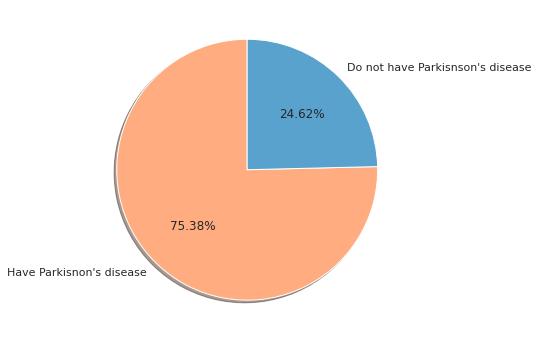

Records with status = 1: 147
Records with status = 0: 48


In [14]:
# Distribution of the target variable
sns.set()
pos = len(df[df['status'] == 1])
neg = len(df[df['status'] == 0])
plt.pie(x=[pos, neg], explode=(0, 0), labels=["Have Parkisnon's disease", "Do not have Parkisnson's disease"], autopct='%1.2f%%', \
        shadow=True, startangle=90,colors = ['#ffac81','#5aa2ce'], normalize = True)
fig = plt.gcf()
fig.set_size_inches(6,6)
plt.show()
print(f'Records with status = 1: {pos}\nRecords with status = 0: {neg}')

<blockquote>
    <p><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 17px;">As only 24.62% of records are from patients without parkinson's disease, the target attribute is heavily imbalanced. So, we might need to employ techniques like upsampling, downsampling or SMOTE so that classification is done properly.</span></p>
</blockquote>

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">Correlation heatmap</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

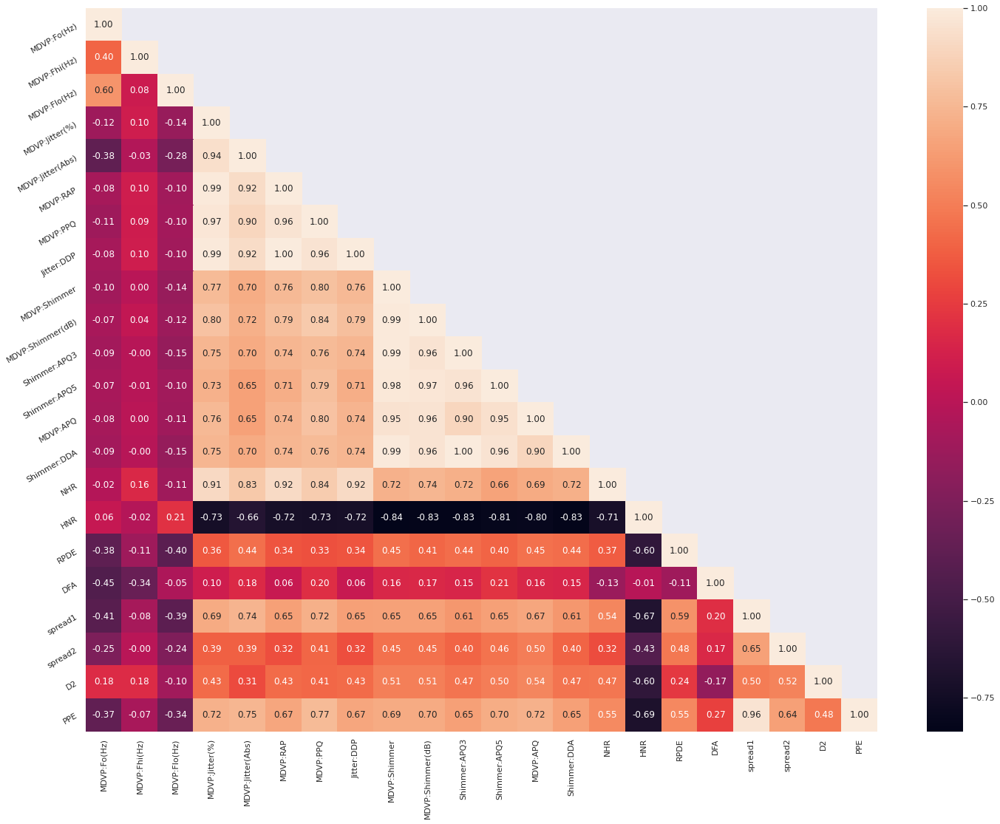

In [15]:
# Correlation with heat map
corr = df.corr()
sns.set_context("notebook", font_scale=1.0, rc={"lines.linewidth": 2.5})
plt.figure(figsize=(24,18))
# create a mask so we only see the correlation values once
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask, 1)] = True
a = sns.heatmap(corr,mask=mask, annot=True, fmt='.2f', cmap=sns.color_palette("rocket", as_cmap = True))
rotx = a.set_xticklabels(a.get_xticklabels(), rotation=90)
roty = a.set_yticklabels(a.get_yticklabels(), rotation=30)

<blockquote>
    <ul style="box-sizing: border-box; text-rendering: auto; -webkit-font-smoothing: antialiased; margin-top: 16px; margin-bottom: 16px; list-style: disc; padding-left: 2em; color: rgba(0, 0, 0, 0.7); font-family: Inter, sans-serif; font-size: 14px; font-style: normal; font-variant-ligatures: normal; font-variant-caps: normal; font-weight: 400; letter-spacing: normal; orphans: 2; text-align: start; text-indent: 0px; text-transform: none; white-space: normal; widows: 2; word-spacing: 0px; -webkit-text-stroke-width: 0px; text-decoration-style: initial; text-decoration-color: initial;">
        <li><span style="color: rgba(0, 0, 0, 0.7); font-family: Candara, Verdana, Geneva, sans-serif; font-size: 17px; font-style: normal; font-variant-ligatures: normal; font-variant-caps: normal; font-weight: 400; letter-spacing: normal; orphans: 2; text-align: left; text-indent: 0px; text-transform: none; white-space: normal; widows: 2; word-spacing: 0px; -webkit-text-stroke-width: 0px; background-color: rgb(255, 255, 255); text-decoration-style: initial; text-decoration-color: initial; float: none; display: inline !important;">If there is multicollinearity, then we are unable to understand &nbsp;and how one variable influences the target. There is no way to estimate separate influence of each variable on the target.<strong><br></strong></span></li>
        <li><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><span style="font-size: 17px;"><span style="color: rgba(0, 0, 0, 0.7); font-style: normal; font-variant-ligatures: normal; font-variant-caps: normal; font-weight: 400; letter-spacing: normal; orphans: 2; text-align: left; text-indent: 0px; text-transform: none; white-space: normal; widows: 2; word-spacing: 0px; -webkit-text-stroke-width: 0px; background-color: rgb(255, 255, 255); text-decoration-style: initial; text-decoration-color: initial; float: none; display: inline !important;"><strong>Spread1</strong> and <strong>PPE</strong> are highly correlated.</span></span></span></li>
        <li style="box-sizing: border-box; text-rendering: auto; -webkit-font-smoothing: antialiased; margin-bottom: 4px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><span style="font-size: 17px;">We can see that attributes <strong>MDVP:Jitter(%), MDVP:Jitter(Abs), MDVP:RAP, MDVP:PPQ, NHR, and Jitter:DDP</strong> are highly correlated with each other</span></span></li>
        <li style="box-sizing: border-box; text-rendering: auto; -webkit-font-smoothing: antialiased; margin-bottom: 4px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><span style="font-size: 17px;">Also, attributes <strong>MDVP:Shimmer, MDVP:Shimmer(dB), Shimmer:APQ3, Shimmer:APQ5, MDVP:APQ, Shimmer:DDA, HNR&nbsp;</strong> are highly correlated to each other.</span></span></li>
        <li style="box-sizing: border-box; text-rendering: auto; -webkit-font-smoothing: antialiased; margin-bottom: 4px;"><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><span style="font-size: 17px;">Hence, we have &nbsp;to replace all these feature with only three features since adding highly correlated variables will not improve model performance but increase complexity.</span></span></li>
        <li style="box-sizing: border-box; text-rendering: auto; -webkit-font-smoothing: antialiased; margin-bottom: 4px;"><span style="font-size: 17px; font-family: Candara, Verdana, Geneva, sans-serif;">So, of the three groups we pick the feature in the group which has the most correlation with the target variable and ideally exhibits a normal or standard distribution.</span></li>
    </ul>
</blockquote>

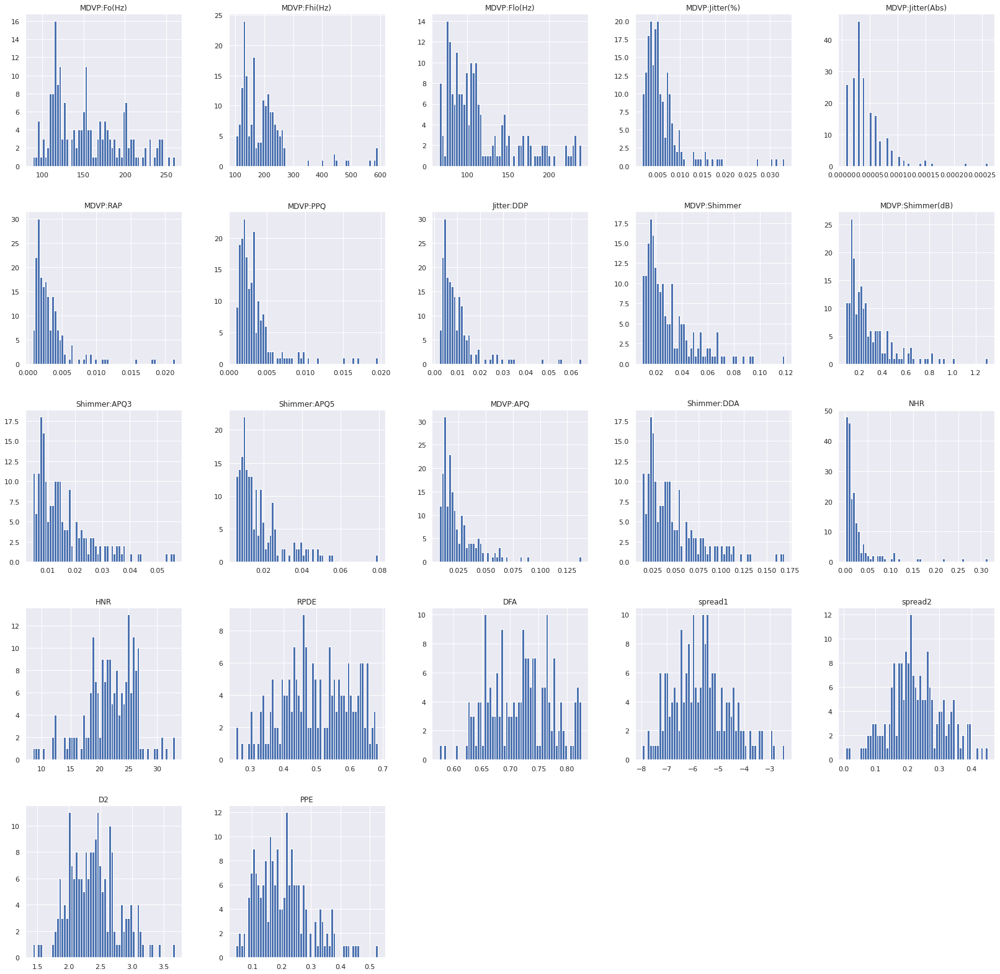

In [16]:
sns.set()
sns.set_style('darkgrid')
df.hist(bins=60, figsize=(28,28))
plt.show()

<blockquote>
	<p><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 17px;"><strong>spread1 and PPE</strong> both seem to be normally distributed. We can confirm this by looking at the describe statement above, which shows mean is almost equal to median<br><strong>All the other highly correlated variables</strong> seem to have a non-standard right-skewed distributed with some outliers lying to the right. Excluding <strong>D2, spread2</strong>, other variables seem to have a non-standard distribution.</span>
	</p>
</blockquote>

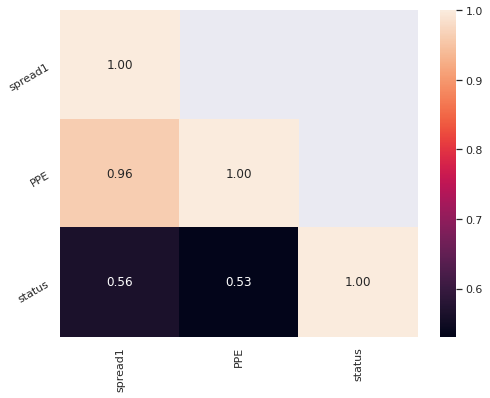

In [17]:
temp_df = df.copy()
temp_df.status = temp_df.status.astype('int32') # to get the correlations
corr = temp_df[['spread1', 'PPE', 'status']].corr()
sns.set_context("notebook", font_scale=1.0, rc={"lines.linewidth": 2.5})
plt.figure(figsize=(8,6))
# create a mask so we only see the correlation values once
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask, 1)] = True
a = sns.heatmap(corr,mask=mask, annot=True, fmt='.2f', cmap=sns.color_palette("rocket", as_cmap = True))
rotx = a.set_xticklabels(a.get_xticklabels(), rotation=90)
roty = a.set_yticklabels(a.get_yticklabels(), rotation=30)

<blockquote>
    <p><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 17px;"><strong>spread1</strong> is more highly correlated with the target variable than <strong>PPE</strong>. So, we select only the feature spread1 of the two for modeling</span></p>
</blockquote>

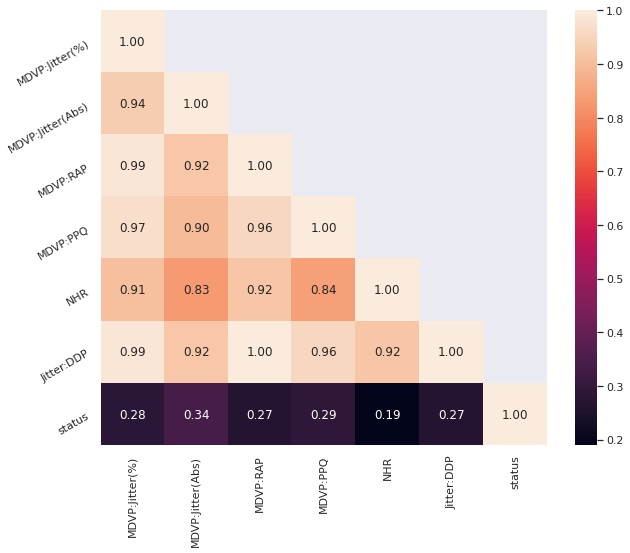

In [18]:
corr = temp_df[['MDVP:Jitter(%)', 'MDVP:Jitter(Abs)', 'MDVP:RAP', 'MDVP:PPQ', 'NHR', 'Jitter:DDP', 'status']].corr()
sns.set_context("notebook", font_scale=1.0, rc={"lines.linewidth": 2.5})
plt.figure(figsize=(10,8))
# create a mask so we only see the correlation values once
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask, 1)] = True
a = sns.heatmap(corr,mask=mask, annot=True, fmt='.2f', cmap=sns.color_palette("rocket", as_cmap = True))
rotx = a.set_xticklabels(a.get_xticklabels(), rotation=90)
roty = a.set_yticklabels(a.get_yticklabels(), rotation=30)

<blockquote>
    <p><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 17px;"><strong>MDVP:Jitter(Abs)</strong> is more highly correlated with the target variable than <strong>the other correlated variables</strong>. So, we select only the feature MDVP:Jitter(Abs) of this group for modeling</span></p>
</blockquote>

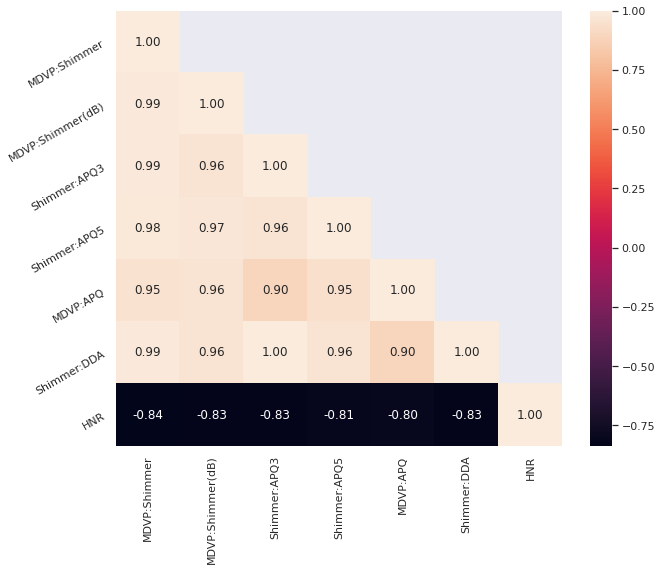

In [19]:
corr = temp_df[['MDVP:Shimmer', 'MDVP:Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5', 'MDVP:APQ', 'Shimmer:DDA', 'HNR']].corr()
sns.set_context("notebook", font_scale=1.0, rc={"lines.linewidth": 2.5})
plt.figure(figsize=(10,8))
# create a mask so we only see the correlation values once
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask, 1)] = True
a = sns.heatmap(corr,mask=mask, annot=True, fmt='.2f', cmap=sns.color_palette("rocket", as_cmap = True))
rotx = a.set_xticklabels(a.get_xticklabels(), rotation=90)
roty = a.set_yticklabels(a.get_yticklabels(), rotation=30)

<blockquote>
    <p><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 17px;"><strong>MDVP:Shimmer</strong> is more highly correlated (albeit negatively) with the target variable than <strong>the other correlated variables</strong>. So, we select only the feature MDVP:Shimmer of this group for modeling</span></p>
</blockquote>

In [20]:
# excluding all the other columns
selected_cols = set(df.columns.tolist()) - set(['MDVP:Shimmer(dB)',
                       'Shimmer:APQ3',
                       'Shimmer:APQ5',
                       'MDVP:APQ',
                       'Shimmer:DDA',
                       'HNR',
                       'MDVP:Jitter(%)',
                       'MDVP:RAP',
                       'MDVP:PPQ',
                       'NHR',
                       'Jitter:DDP',
                       'PPE',
                       'name'])
selected_cols = list(selected_cols)
selected_cols

['spread2',
 'status',
 'MDVP:Flo(Hz)',
 'DFA',
 'spread1',
 'MDVP:Fhi(Hz)',
 'RPDE',
 'MDVP:Fo(Hz)',
 'MDVP:Shimmer',
 'MDVP:Jitter(Abs)',
 'D2']

In [21]:
selected_df = df[selected_cols]
selected_df.describe().T

,count,mean,std,min,25%,50%,75%,max
spread2,195.0,0.226510,0.083406,0.006274,0.174351,0.218885,0.279234,0.450493
MDVP:Flo(Hz),195.0,116.324631,43.521413,65.476000,84.291000,104.315000,140.018500,239.170000
DFA,195.0,0.718099,0.055336,0.574282,0.674758,0.722254,0.761881,0.825288
spread1,195.0,-5.684397,1.090208,-7.964984,-6.450096,-5.720868,-5.046192,-2.434031
MDVP:Fhi(Hz),195.0,197.104918,91.491548,102.145000,134.862500,175.829000,224.205500,592.030000
RPDE,195.0,0.498536,0.103942,0.256570,0.421306,0.495954,0.587562,0.685151
MDVP:Fo(Hz),195.0,154.228641,41.390065,88.333000,117.572000,148.790000,182.769000,260.105000
MDVP:Shimmer,195.0,0.029709,0.018857,0.009540,0.016505,0.022970,0.037885,0.119080
MDVP:Jitter(Abs),195.0,0.000044,0.000035,0.000007,0.000020,0.000030,0.000060,0.000260
D2,195.0,2.381826,0.382799,1.423287,2.099125,2.361532,2.636456,3.671155


In [22]:
selected_df = selected_df.astype({"status":'int32'}) # to help in plotting, will be converted later

In [23]:
selected_df.head()

,spread2,status,MDVP:Flo(Hz),DFA,spread1,MDVP:Fhi(Hz),RPDE,MDVP:Fo(Hz),MDVP:Shimmer,MDVP:Jitter(Abs),D2
0,0.266482,1,74.997,0.815285,-4.813031,157.302,0.414783,119.992,0.04374,0.00007,2.301442
1,0.335590,1,113.819,0.819521,-4.075192,148.650,0.458359,122.400,0.06134,0.00008,2.486855
2,0.311173,1,111.555,0.825288,-4.443179,131.111,0.429895,116.682,0.05233,0.00009,2.342259
3,0.334147,1,111.366,0.819235,-4.117501,137.871,0.434969,116.676,0.05492,0.00009,2.405554
4,0.234513,1,110.655,0.823484,-3.747787,141.781,0.417356,116.014,0.06425,0.00011,2.332180


In [24]:
selected_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   spread2           195 non-null    float64
 1   status            195 non-null    int64  
 2   MDVP:Flo(Hz)      195 non-null    float64
 3   DFA               195 non-null    float64
 4   spread1           195 non-null    float64
 5   MDVP:Fhi(Hz)      195 non-null    float64
 6   RPDE              195 non-null    float64
 7   MDVP:Fo(Hz)       195 non-null    float64
 8   MDVP:Shimmer      195 non-null    float64
 9   MDVP:Jitter(Abs)  195 non-null    float64
 10  D2                195 non-null    float64
dtypes: float64(10), int64(1)
memory usage: 16.9 KB


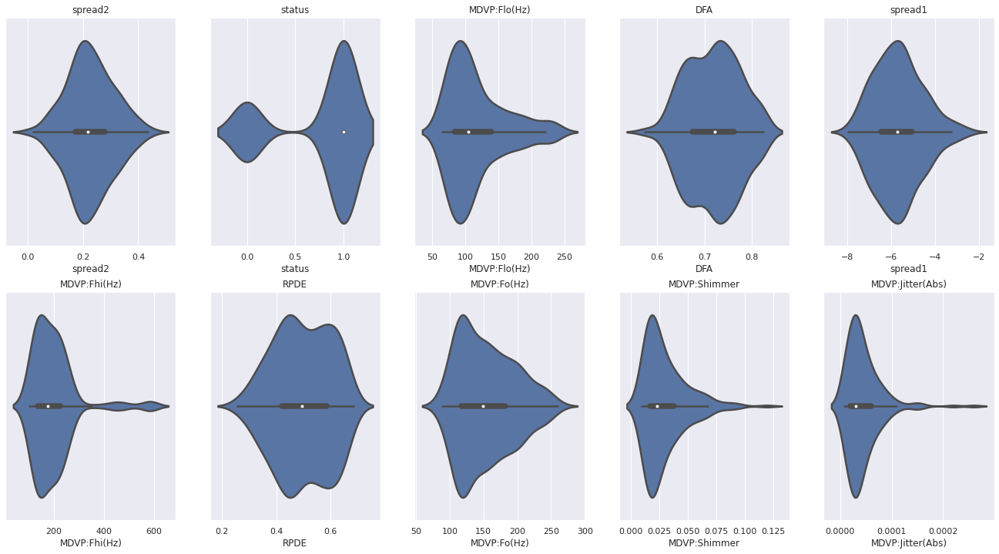

In [25]:
warnings.filterwarnings('ignore')
fig, ax = plt.subplots(nrows = 2, ncols = 5, figsize = [23, 12])
for col, ax in zip(selected_cols, ax.flatten()):
  sns.violinplot(x = col, data = selected_df, ax =ax)
  ax.set_title(col)

<blockquote>
    <ul>
        <li><span style="font-size: 17px; font-family: Candara, Verdana, Geneva, sans-serif;">Distribution of attributes <strong>MDVP:Fo(Hz), RPDE, DFA, spread2, D2, PPE</strong> are fairly normal.</span></li>
        <li><span style="font-size: 17px; font-family: Candara, Verdana, Geneva, sans-serif;">Attributes <strong>MDVP:Fhi(Hz), MDVP:Flo(Hz), MDVP:Shimmer, MDVP:Jitter(Abs)</strong> are right skewed with a few outliers.</span></li>
    </ul>
</blockquote>

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">Bivariate Plots with target</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

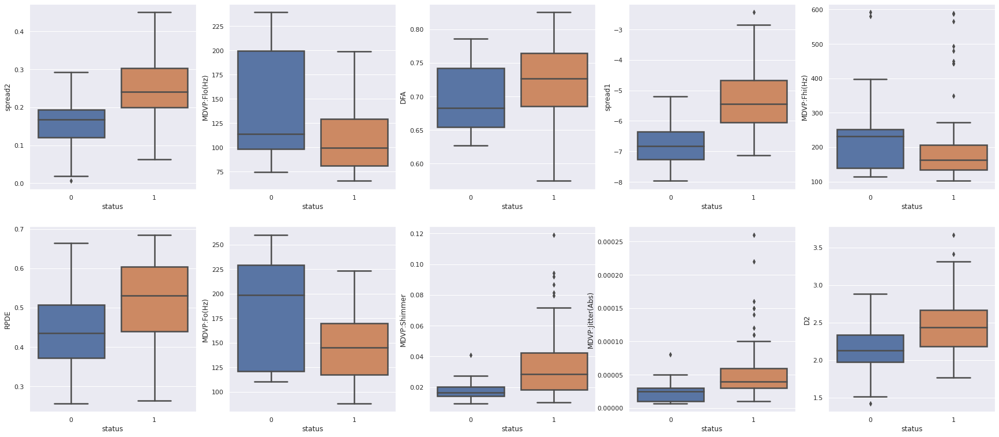

In [26]:
cols = list(set(selected_cols) - {'status'})
fig=plt.figure(figsize=(30,13))
for i,col in enumerate(cols):
    ax=fig.add_subplot(2,5,i+1)
    sns.boxplot(y = selected_df[col], x = selected_df['status'])

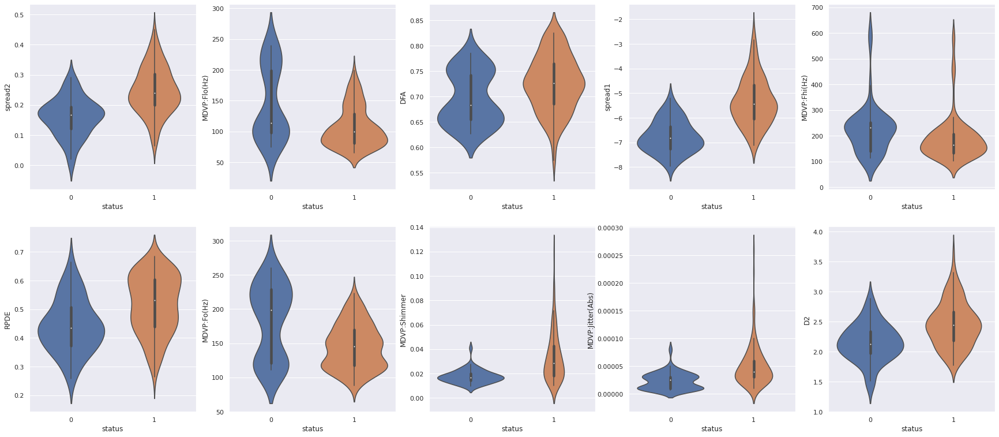

In [27]:
sns.set()
fig=plt.figure(figsize=(30,13))
for i,col in enumerate(cols):
    ax=fig.add_subplot(2,5,i+1)
    sns.violinplot(y = selected_df[col], x = selected_df['status'])

<blockquote>
    <ul>
        <li><strong><span style="font-family: Candara, Verdana, Geneva, sans-serif; font-size: 17px;">Patient PD Status</span></strong><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><span style="font-size: 17px;">&nbsp;doesn&apos;t show much variations with <strong>MDVP:Fhi(Hz) and D2.</strong></span></span></li>
        <li><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><span style="font-size: 17px;"><strong><strong>spread1 and spread2</strong> has a good effect on the target varialbe.</strong></span></span></li>
        <li><span style="font-family: Candara, Verdana, Geneva, sans-serif;"><span style="font-size: 17px;"><strong><strong>Other predictors</strong> </strong>also show a weak relationship with the target variable. </span></span></li>
    </ul>
</blockquote>

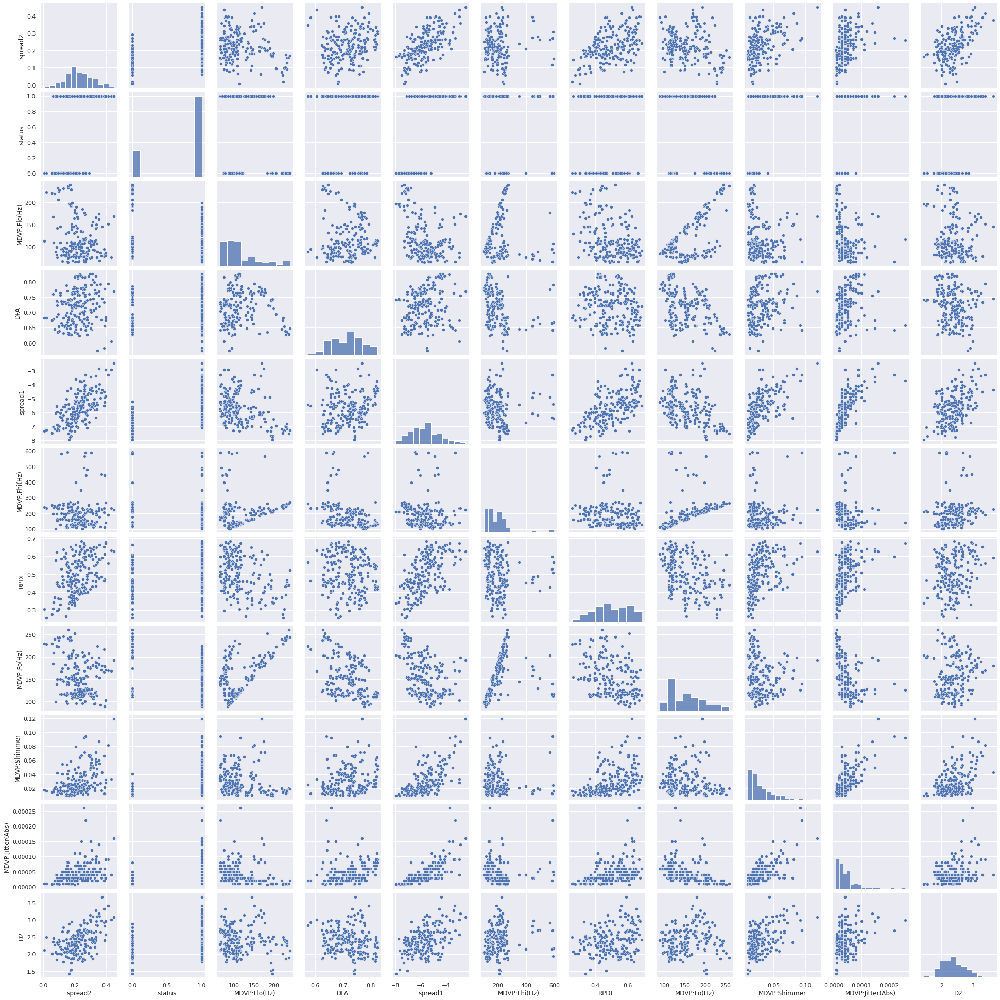

In [28]:
sns.pairplot(selected_df)

<blockquote>
    <ul>
        <li><span style="font-size: 17px; font-family: Candara, Verdana, Geneva, sans-serif;">Now, we can see that all the selected features are independent and some have a normal distribution.</span></li>
    </ul>
</blockquote>

<h2><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 22px;">Data Preprocessing</span></h2>

In [29]:
# Since pandas assumed wrong types of status attribute
selected_df = selected_df.astype({"status":'category'})

In [30]:
selected_df.sample(7)

,spread2,status,MDVP:Flo(Hz),DFA,spread1,MDVP:Fhi(Hz),RPDE,MDVP:Fo(Hz),MDVP:Shimmer,MDVP:Jitter(Abs),D2
3,0.334147,1,111.366,0.819235,-4.117501,137.871,0.434969,116.676,0.05492,0.000090,2.405554
43,0.158266,0,232.483,0.634267,-6.793547,248.834,0.457702,241.404,0.01760,0.000010,2.256699
80,0.155097,1,84.510,0.770466,-4.441519,108.664,0.544805,96.106,0.04024,0.000070,2.645959
73,0.306636,1,107.024,0.789532,-5.389129,588.518,0.509127,112.014,0.02448,0.000050,1.928708
190,0.121952,0,94.261,0.657899,-6.538586,230.978,0.448439,174.188,0.04087,0.000030,2.657476
185,0.133917,0,96.983,0.654331,-5.592584,177.291,0.598515,116.286,0.01564,0.000030,2.058658
33,0.178540,0,197.079,0.742133,-7.695734,211.604,0.368535,202.266,0.00954,0.000009,1.544609


In [31]:
selected_df.describe().T # the scales are very different, need to apply standardization

,count,mean,std,min,25%,50%,75%,max
spread2,195.0,0.226510,0.083406,0.006274,0.174351,0.218885,0.279234,0.450493
MDVP:Flo(Hz),195.0,116.324631,43.521413,65.476000,84.291000,104.315000,140.018500,239.170000
DFA,195.0,0.718099,0.055336,0.574282,0.674758,0.722254,0.761881,0.825288
spread1,195.0,-5.684397,1.090208,-7.964984,-6.450096,-5.720868,-5.046192,-2.434031
MDVP:Fhi(Hz),195.0,197.104918,91.491548,102.145000,134.862500,175.829000,224.205500,592.030000
RPDE,195.0,0.498536,0.103942,0.256570,0.421306,0.495954,0.587562,0.685151
MDVP:Fo(Hz),195.0,154.228641,41.390065,88.333000,117.572000,148.790000,182.769000,260.105000
MDVP:Shimmer,195.0,0.029709,0.018857,0.009540,0.016505,0.022970,0.037885,0.119080
MDVP:Jitter(Abs),195.0,0.000044,0.000035,0.000007,0.000020,0.000030,0.000060,0.000260
D2,195.0,2.381826,0.382799,1.423287,2.099125,2.361532,2.636456,3.671155


In [32]:
selected_df.dtypes

spread2              float64
status              category
MDVP:Flo(Hz)         float64
DFA                  float64
spread1              float64
MDVP:Fhi(Hz)         float64
RPDE                 float64
MDVP:Fo(Hz)          float64
MDVP:Shimmer         float64
MDVP:Jitter(Abs)     float64
D2                   float64
dtype: object

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">Over Sampling SMOTE</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

In [33]:
# !conda install -c conda-forge imbalanced-learn
# (or)
# !pip install imbearn

In [34]:
X = selected_df.drop('status', axis = 1)
y = selected_df.status

In [35]:
features = list(X.columns)
features

['spread2',
 'MDVP:Flo(Hz)',
 'DFA',
 'spread1',
 'MDVP:Fhi(Hz)',
 'RPDE',
 'MDVP:Fo(Hz)',
 'MDVP:Shimmer',
 'MDVP:Jitter(Abs)',
 'D2']

In [36]:
from imblearn.over_sampling import SMOTE

# for reproducibility purposes
seed = 77
# SMOTE number of neighbors
k = 1
smote = SMOTE(sampling_strategy='auto', k_neighbors=k, random_state=seed)
X_resampled, y_resampled = smote.fit_sample(X, y)

In [37]:
X_resampled.sample(7)

,spread2,MDVP:Flo(Hz),DFA,spread1,MDVP:Fhi(Hz),RPDE,MDVP:Fo(Hz),MDVP:Shimmer,MDVP:Jitter(Abs),D2
246,0.255465,119.616644,0.780030,-6.905449,139.338246,0.431856,128.947082,0.024394,0.000037,2.150474
135,0.322044,105.554000,0.706687,-5.333619,127.611000,0.653427,110.453000,0.041280,0.000040,2.631793
237,0.079867,102.260887,0.683783,-7.208774,238.485819,0.412332,218.591195,0.018909,0.000010,2.368298
238,0.196549,108.201993,0.741229,-5.890837,123.287219,0.449131,115.783178,0.015917,0.000032,1.986295
277,0.175144,192.075472,0.741758,-7.538399,208.383643,0.428035,198.299779,0.010508,0.000010,1.948156
39,0.266892,173.015000,0.758324,-6.006647,202.324000,0.396793,187.733000,0.016630,0.000020,2.382544
216,0.173728,192.087520,0.741988,-7.650271,209.259105,0.431452,199.019961,0.010230,0.000010,2.068377


In [38]:
X_resampled.shape # 294 records, with 10 features

(294, 10)

In [39]:
y_resampled.value_counts()
# balanced dataset with a total of 294 records!

0    147
1    147
Name: status, dtype: int64

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">Split Training and Testing Datasets</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

In [40]:
from sklearn.model_selection import train_test_split
# for reproducibility purposes
seed = 77
# 70-30 train test split
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.3,random_state=seed)
X_train.shape, X_test.shape

((205, 10), (89, 10))

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">Scaling</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

In [41]:
X_train = pd.DataFrame(X_train, columns = features)
X_test = pd.DataFrame(X_test, columns = features)
X_train.head()

,spread2,MDVP:Flo(Hz),DFA,spread1,MDVP:Fhi(Hz),RPDE,MDVP:Fo(Hz),MDVP:Shimmer,MDVP:Jitter(Abs),D2
194,0.190667,77.973000,0.664357,-5.724056,260.277000,0.462803,214.289000,0.018840,0.000030,2.555477
270,0.157414,107.540125,0.760368,-6.151594,130.942743,0.384103,114.700704,0.015638,0.000030,2.087609
210,0.177230,78.084330,0.672829,-6.252512,261.337912,0.482745,208.825083,0.021852,0.000030,2.451075
89,0.375531,144.878000,0.745526,-4.379411,225.930000,0.590951,179.711000,0.043130,0.000040,3.671155
227,0.142660,234.379036,0.636895,-7.207383,265.588237,0.486613,245.330249,0.017079,0.000013,2.289496


In [42]:
# to help models learn when there's variation in units or variable data ranges
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()

# fit on only trian dataset to avoid data leakage
scaler.fit(X_train[features])

# standardize all numerical variables excluding the target | mean = 0, standard deviation = 1
X_train[features] = scaler.transform(X_train[features])

X_test[features] = scaler.transform(X_test[features])
X_train.head()

,spread2,MDVP:Flo(Hz),DFA,spread1,MDVP:Fhi(Hz),RPDE,MDVP:Fo(Hz),MDVP:Shimmer,MDVP:Jitter(Abs),D2
194,-0.096299,-0.970251,-0.860203,0.344103,0.616699,-0.051619,1.039309,-0.361654,-0.181816,0.746692
270,-0.513710,-0.407768,0.919848,-0.055826,-0.803144,-0.858875,-1.069381,-0.560460,-0.181816,-0.550158
210,-0.264969,-0.968133,-0.703140,-0.150228,0.628345,0.152929,0.923616,-0.174627,-0.181816,0.457307
89,2.224251,0.302545,0.644673,1.601918,0.239634,1.262836,0.307152,1.146376,0.160130,3.839161
227,-0.698916,2.005206,-1.369347,-1.043438,0.675006,0.192606,1.696579,-0.470985,-0.747506,0.009438


In [43]:
X_train.describe().T

,count,mean,std,min,25%,50%,75%,max
spread2,205.0,2.204199e-16,1.002448,-2.255094,-0.584010,-0.147129,0.638099,3.165229
MDVP:Flo(Hz),205.0,4.920184e-16,1.002448,-1.207993,-0.786385,-0.408226,0.865653,2.060831
DFA,205.0,-1.253740e-15,1.002448,-2.530197,-0.908815,0.149895,0.849891,2.050712
spread1,205.0,7.495359e-16,1.002448,-1.752117,-0.831862,-0.056722,0.574652,3.421675
MDVP:Fhi(Hz),205.0,-2.323345e-16,1.002448,-1.119288,-0.725098,-0.031316,0.382975,4.258711
RPDE,205.0,5.740665e-17,1.002448,-2.167017,-0.715728,-0.105593,0.758484,2.146813
MDVP:Fo(Hz),205.0,-2.112132e-16,1.002448,-1.627693,-1.014894,-0.186331,0.794479,2.009421
MDVP:Shimmer,205.0,-3.043636e-16,1.002448,-0.939040,-0.603784,-0.361654,0.242427,5.861688
MDVP:Jitter(Abs),205.0,-3.838393e-16,1.002448,-0.968292,-0.747506,-0.181816,0.160130,6.315157
D2,205.0,3.168197e-16,1.002448,-2.391546,-0.743788,-0.055514,0.556483,3.839161


<blockquote>
    <ul>
        <li><span style="font-size: 17px;">Now, we can see that the scales or ranges of all the features are similar with mean being approximately zero and standard deviation of approximately one. Hence, we can proceed to train the models on this dataset.</span></li>
    </ul>
</blockquote>

<h2><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 22px;">Model Building</span></h2>

<h2><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 22px;">Base Models</span></h2>

In [44]:
# models
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, StackingClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score,confusion_matrix
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import f1_score
from collections import defaultdict
from pprint import pprint

In [45]:
# utility funciton
def plot_confusion_matrix(y_true, y_pred, ax, class_names  = ['Positive', 'Negative'], vmax=None,
                           normalized=True, title='Confusion matrix'):
    """
    Helper fuction to generate a clean Confusion Matrix using seaborn library.
    y_true: True labels, y_pred: Model Predictions, class_names: Override if needed
    normalized: True, gives the proportions instead of absolute numbers
    """
    matrix = confusion_matrix(y_true,y_pred)
    if normalized:
        matrix = matrix.astype('float') / matrix.sum(axis=1)[:, np.newaxis]
    annot_kws = {'fontsize':25, 
                'fontstyle': 'italic'}
    sns.heatmap(matrix, vmax=vmax, annot=True,  annot_kws = annot_kws,
                square=True, ax=ax, cbar=False,
                cmap=sns.diverging_palette(10, 200, as_cmap=True), 
                linecolor='black', linewidths=0.5,
                xticklabels=class_names)
    ax.set_title(title, y=1.20, fontsize=16)
    ax.set_ylabel('True labels', fontsize=12)
    ax.set_xlabel('Predicted labels', y=1.10, fontsize=12)
    ax.set_yticklabels(class_names, rotation=0)

def plot_feature_importance(importance,names,model_type):
    """"Create arrays from feature importance and feature names"""
    feature_importance = np.array(importance)
    feature_names = np.array(names)

    #Create a DataFrame using a Dictionary
    data={'feature_names':feature_names,'feature_importance':feature_importance}
    fi_df = pd.DataFrame(data)

    #Sort the DataFrame in order decreasing feature importance
    fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)

    #Define size of bar plot
    plt.figure(figsize=(10,8))
    #Plot Searborn bar chart
    sns.barplot(x=fi_df['feature_importance'], y=fi_df['feature_names'])
    #Add chart labels
    plt.title(model_type + 'FEATURE IMPORTANCE')
    plt.xlabel('FEATURE IMPORTANCE')
    plt.ylabel('FEATURE NAMES')

In [46]:
models = defaultdict(dict)

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">Logistic Regression</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

In [47]:
# hyper paramter tuning
parameters = {
    'C': np.linspace(1, 10, 10),
    'penalty': ['l1', 'l2']
             }
clf = GridSearchCV(LogisticRegression(), parameters, cv=6, verbose=5, n_jobs=-1)

In [48]:
clf.fit(X_train, y_train)

Fitting 6 folds for each of 20 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    0.4s finished


GridSearchCV(cv=6, estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': array([ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.]),
                         'penalty': ['l1', 'l2']},
             verbose=5)

In [49]:
clf.best_params_

{'C': 5.0, 'penalty': 'l2'}

In [50]:
lr = LogisticRegression(C = 5.0, penalty = 'l2', random_state = seed)
lr.fit(X_train, y_train)

LogisticRegression(C=5.0, random_state=77)

In [51]:
lr_pred = lr.predict(X_test)
lr_score = f1_score(y_test, lr_pred)
lr_acc = accuracy_score(y_test, lr_pred)

models['LogisticRegression']['name'] = 'Logistic Regression'
models['LogisticRegression']['f1'] = lr_score
models['LogisticRegression']['accuracy'] = lr_acc
pprint(models['LogisticRegression'], indent = 2, compact = True)

{ 'accuracy': 0.8314606741573034,
  'f1': 0.8484848484848485,
  'name': 'Logistic Regression'}


In [52]:
print(classification_report(y_test, lr_pred))

              precision    recall  f1-score   support

           0       0.89      0.74      0.81        43
           1       0.79      0.91      0.85        46

    accuracy                           0.83        89
   macro avg       0.84      0.83      0.83        89
weighted avg       0.84      0.83      0.83        89



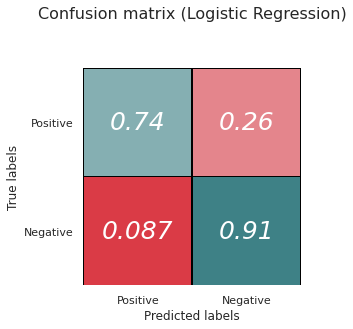

In [53]:
fig, axis1 = plt.subplots(nrows=1, ncols=1)
plot_confusion_matrix(y_test, lr_pred,  ax=axis1, title='Confusion matrix (Logistic Regression)')

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">KNearest Neighbors Classifier</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

In [54]:
# hyper paramter tuning
parameters = {
    'leaf_size' : np.linspace(1, 10, 5),
    'n_neighbors' : list(range(2,10)),
    'weights': ['uniform', 'distance'],
    'metric' : ['euclidean', 'manhattan']
             }
clf = GridSearchCV(KNeighborsClassifier(), parameters, cv=6, verbose=5, n_jobs=-1)

In [55]:
clf.fit(X_train, y_train)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


Fitting 6 folds for each of 160 candidates, totalling 960 fits


[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 176 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 907 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 960 out of 960 | elapsed:    2.5s finished


GridSearchCV(cv=6, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'leaf_size': array([ 1.  ,  3.25,  5.5 ,  7.75, 10.  ]),
                         'metric': ['euclidean', 'manhattan'],
                         'n_neighbors': [2, 3, 4, 5, 6, 7, 8, 9],
                         'weights': ['uniform', 'distance']},
             verbose=5)

In [56]:
clf.best_params_

{'leaf_size': 1.0,
 'metric': 'manhattan',
 'n_neighbors': 2,
 'weights': 'distance'}

In [57]:
knn = KNeighborsClassifier(n_neighbors = 2, leaf_size = 1.0, metric = 'manhattan', weights = 'distance')
knn.fit(X_train, y_train)

KNeighborsClassifier(leaf_size=1.0, metric='manhattan', n_neighbors=2,
                     weights='distance')

In [58]:
knn_pred = knn.predict(X_test)
knn_score = f1_score(y_test, knn_pred)
knn_acc = accuracy_score(y_test, knn_pred)

models['KNeighborsClassifier']['name'] = 'K Nearest Neighbors Classifier'
models['KNeighborsClassifier']['f1'] = knn_score
models['KNeighborsClassifier']['accuracy'] = knn_acc
pprint(models['KNeighborsClassifier'], indent = 2, compact = True)

{ 'accuracy': 0.9662921348314607,
  'f1': 0.9662921348314606,
  'name': 'K Nearest Neighbors Classifier'}


In [59]:
print(classification_report(y_test, knn_pred))

              precision    recall  f1-score   support

           0       0.93      1.00      0.97        43
           1       1.00      0.93      0.97        46

    accuracy                           0.97        89
   macro avg       0.97      0.97      0.97        89
weighted avg       0.97      0.97      0.97        89



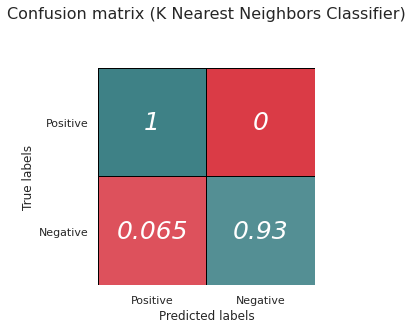

In [60]:
fig, axis1 = plt.subplots(nrows=1, ncols=1)
plot_confusion_matrix(y_test, knn_pred,  ax=axis1, title='Confusion matrix (K Nearest Neighbors Classifier)')

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">Naïve Bayes Classifier</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

In [61]:
naive_model = GaussianNB()
naive_model.fit(X_train, y_train)

nb_pred = naive_model.predict(X_test)
nb_score = f1_score(y_test, nb_pred)
nb_acc = accuracy_score(y_test, nb_pred)

models['GuassianNB']['name'] = 'Naive Bayes Classifier'
models['GuassianNB']['f1'] = nb_score
models['GuassianNB']['accuracy'] = nb_acc
pprint(models['GuassianNB'], indent = 2, compact = True)

{ 'accuracy': 0.7640449438202247,
  'f1': 0.7961165048543689,
  'name': 'Naive Bayes Classifier'}


In [62]:
print(classification_report(y_test, nb_pred))

              precision    recall  f1-score   support

           0       0.84      0.63      0.72        43
           1       0.72      0.89      0.80        46

    accuracy                           0.76        89
   macro avg       0.78      0.76      0.76        89
weighted avg       0.78      0.76      0.76        89



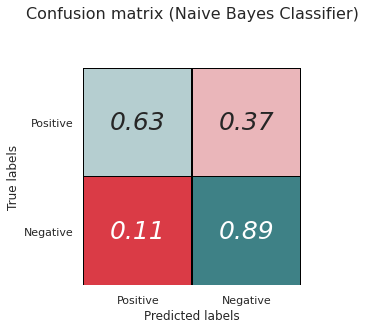

In [63]:
fig, axis1 = plt.subplots(nrows=1, ncols=1)
plot_confusion_matrix(y_test, nb_pred,  ax=axis1, title='Confusion matrix (Naive Bayes Classifier)')

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">Support Vector Classifier</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

In [64]:
# hyper paramter tuning
parameters = {'C':[1,10,100],'gamma':[1,0.1,0.001], 'kernel':['linear','rbf']}
clf = GridSearchCV(SVC(), parameters, cv=6, verbose=5, n_jobs=-1)

In [65]:
clf.fit(X_train, y_train)

Fitting 6 folds for each of 18 candidates, totalling 108 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  93 out of 108 | elapsed:    0.4s remaining:    0.1s
[Parallel(n_jobs=-1)]: Done 108 out of 108 | elapsed:    0.5s finished


GridSearchCV(cv=6, estimator=SVC(), n_jobs=-1,
             param_grid={'C': [1, 10, 100], 'gamma': [1, 0.1, 0.001],
                         'kernel': ['linear', 'rbf']},
             verbose=5)

In [66]:
clf.best_params_

{'C': 10, 'gamma': 1, 'kernel': 'rbf'}

In [67]:
svc = SVC(C = 10, gamma = 1, kernel = 'rbf', probability = False, random_state = seed)
svc.fit(X_train, y_train)

SVC(C=10, gamma=1, random_state=77)

In [68]:
svc_pred = svc.predict(X_test)
svc_score = f1_score(y_test, svc_pred)
svc_acc = accuracy_score(y_test, svc_pred)

models['SVC']['name'] = 'Support Vector Classifier'
models['SVC']['f1'] = svc_score
models['SVC']['accuracy'] = svc_acc
pprint(models['SVC'], indent = 2, compact = True)

{'accuracy': 1.0, 'f1': 1.0, 'name': 'Support Vector Classifier'}


In [69]:
print(classification_report(y_test, svc_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        43
           1       1.00      1.00      1.00        46

    accuracy                           1.00        89
   macro avg       1.00      1.00      1.00        89
weighted avg       1.00      1.00      1.00        89



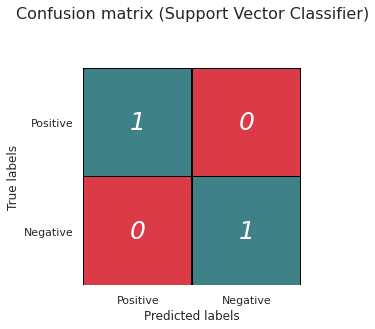

In [70]:
fig, axis1 = plt.subplots(nrows=1, ncols=1)
plot_confusion_matrix(y_test, svc_pred,  ax=axis1, title='Confusion matrix (Support Vector Classifier)')

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">Decision Tree Classifier</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

In [71]:
# hyper paramter tuning
parameters = {'criterion' : ['gini', 'entropy'],
               'max_depth': list(range(3, 25))
             }
clf = GridSearchCV(DecisionTreeClassifier(), parameters, cv=6, verbose=5, n_jobs=-1)

In [72]:
clf.fit(X_train, y_train)

Fitting 6 folds for each of 44 candidates, totalling 264 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 176 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 249 out of 264 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 264 out of 264 | elapsed:    0.6s finished


GridSearchCV(cv=6, estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14,
                                       15, 16, 17, 18, 19, 20, 21, 22, 23,
                                       24]},
             verbose=5)

In [73]:
clf.best_params_

{'criterion': 'gini', 'max_depth': 13}

In [74]:
dtree = DecisionTreeClassifier(criterion = 'gini', max_depth = 14, random_state = seed)
dtree.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=14, random_state=77)

In [75]:
dtree_pred = dtree.predict(X_test)
dtree_score = f1_score(y_test, dtree_pred)
dtree_acc = accuracy_score(y_test, dtree_pred)

models['DecisionTreeClassifier']['name'] = 'Decision Tree Classifier'
models['DecisionTreeClassifier']['f1'] = dtree_score
models['DecisionTreeClassifier']['accuracy'] = dtree_acc
pprint(models['DecisionTreeClassifier'], indent = 2, compact = True)

{ 'accuracy': 0.9662921348314607,
  'f1': 0.967032967032967,
  'name': 'Decision Tree Classifier'}


In [76]:
print(classification_report(y_test, dtree_pred))

              precision    recall  f1-score   support

           0       0.95      0.98      0.97        43
           1       0.98      0.96      0.97        46

    accuracy                           0.97        89
   macro avg       0.97      0.97      0.97        89
weighted avg       0.97      0.97      0.97        89



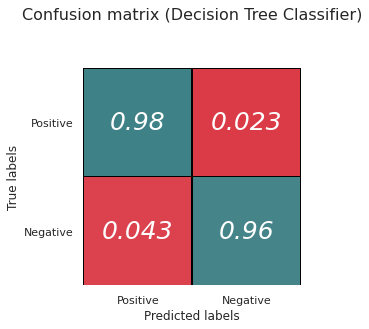

In [77]:
fig, axis1 = plt.subplots(nrows=1, ncols=1)
plot_confusion_matrix(y_test, dtree_pred,  ax=axis1, title='Confusion matrix (Decision Tree Classifier)')

<h2><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 22px;">Train a meta classifier</span></h2>

Meta Classifier is simply the classifier that makes a final prediction among all the predictions by using those predictions as features. So, it takes classes predicted by various classifiers and pick the final one as the result that you need.

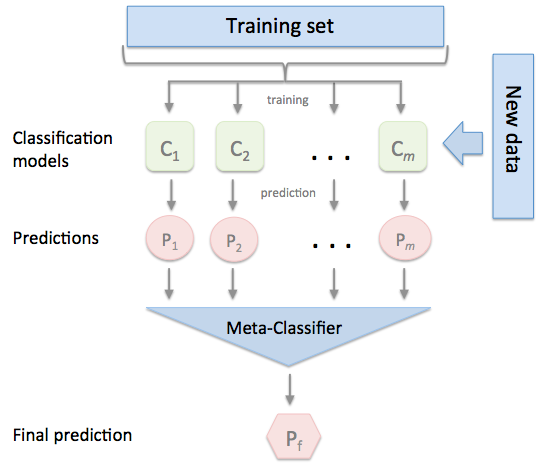

In [78]:
# the meta_classifier here is lr, which takes the outputs of all these individual learners and trains on those outputs
# using all previous models' outputs
# get a stacking ensemble of models
meta_classifier = LogisticRegression()
meta = StackingClassifier(estimators= [('lr', lr), ('knn', knn), ('cart', dtree), ('svm', svc), ('bayes', naive_model)], \
                          final_estimator = meta_classifier)
meta.fit(X_train, y_train)

StackingClassifier(estimators=[('lr',
                                LogisticRegression(C=5.0, random_state=77)),
                               ('knn',
                                KNeighborsClassifier(leaf_size=1.0,
                                                     metric='manhattan',
                                                     n_neighbors=2,
                                                     weights='distance')),
                               ('cart',
                                DecisionTreeClassifier(max_depth=14,
                                                       random_state=77)),
                               ('svm', SVC(C=10, gamma=1, random_state=77)),
                               ('bayes', GaussianNB())],
                   final_estimator=LogisticRegression())

In [79]:
meta_pred = meta.predict(X_test)
meta_score = f1_score(y_test, meta_pred)
meta_acc = accuracy_score(y_test, meta_pred)

models['Meta Classifier']['name'] = 'Meta Classifier'
models['Meta Classifier']['f1'] = meta_score
models['Meta Classifier']['accuracy'] = meta_acc
pprint(models['Meta Classifier'], indent = 2, compact = True)

{'accuracy': 1.0, 'f1': 1.0, 'name': 'Meta Classifier'}


In [80]:
print(classification_report(y_test, meta_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        43
           1       1.00      1.00      1.00        46

    accuracy                           1.00        89
   macro avg       1.00      1.00      1.00        89
weighted avg       1.00      1.00      1.00        89



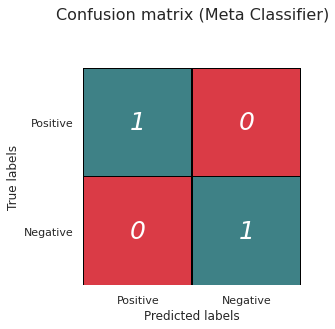

In [81]:
fig, axis1 = plt.subplots(nrows=1, ncols=1)
plot_confusion_matrix(y_test, meta_pred,  ax=axis1, title='Confusion matrix (Meta Classifier)')

<h2><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 22px;">Ensemble Models</span></h2>

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">XGBoost Classifier (Boosting model)</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

In [82]:
parameterss = {'booster': ['gbtree', 'gblinear'],
          'gamma': [ 1.5, 2, 3, 4],
          'subsample': [0.6, 0.8, 1.0],
          'colsample_bytree': [0.6, 0.8, 1.0],
          'max_depth': [3, 4, 5]}
clf = GridSearchCV(XGBClassifier(), parameters, cv=4, verbose=6, n_jobs=-1)

In [83]:
clf.fit(X_train, y_train)

Fitting 4 folds for each of 44 candidates, totalling 176 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:   10.9s
[Parallel(n_jobs=-1)]: Done 176 out of 176 | elapsed:   19.2s finished


[21:36:13] WARNING: /home/conda/feedstock_root/build_artifacts/xgboost_1607604574104/work/src/learner.cc:541: 
Parameters: { criterion } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[21:36:13] WARNING: /home/conda/feedstock_root/build_artifacts/xgboost_1607604574104/work/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


GridSearchCV(cv=4,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, random_state=None,
                                     reg_alpha=None, reg_lambda=None,
                                     scale_pos_weight=None, subsample=None,
                                     tree_method=None,

In [84]:
clf.best_params_

{'criterion': 'gini', 'max_depth': 5}

In [85]:
xgb = XGBClassifier(n_estimators = 100, max_depth = 5, random_state = seed)
xgb.fit(X_train, y_train)

[21:36:13] WARNING: /home/conda/feedstock_root/build_artifacts/xgboost_1607604574104/work/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=8, num_parallel_tree=1, random_state=77,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [86]:
xgb_pred = xgb.predict(X_test)
xgb_score = f1_score(y_test, xgb_pred)
xgb_acc = accuracy_score(y_test, xgb_pred)

models['XGBoost Classifier']['name'] = 'XGBoost Classifier'
models['XGBoost Classifier']['f1'] = xgb_score
models['XGBoost Classifier']['accuracy'] = xgb_acc
pprint(models['XGBoost Classifier'], indent = 2, compact = True)

{ 'accuracy': 0.9550561797752809,
  'f1': 0.9583333333333334,
  'name': 'XGBoost Classifier'}


In [87]:
print(classification_report(y_test, xgb_pred))

              precision    recall  f1-score   support

           0       1.00      0.91      0.95        43
           1       0.92      1.00      0.96        46

    accuracy                           0.96        89
   macro avg       0.96      0.95      0.95        89
weighted avg       0.96      0.96      0.95        89



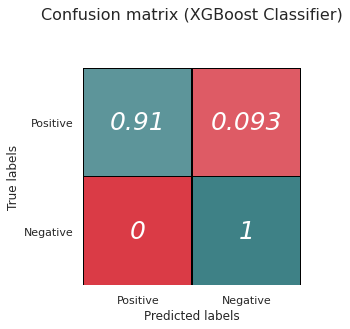

In [88]:
fig, axis1 = plt.subplots(nrows=1, ncols=1) 
plot_confusion_matrix(y_test, xgb_pred,  ax=axis1, title='Confusion matrix (XGBoost Classifier)')

<p><strong><span style="font-size: 17px; font-family: Candara, Lato, Arial, Verdana;">Random Forest Classifier (Bagging model)</span></strong><span style="font-size: 17px;"><span style="font-family: Candara, Lato, Arial, Verdana;"></span></span></p>

In [89]:
# hyper paramter tuning
parameters = {'max_features': ['auto', 'sqrt'],
              'n_estimators' : [100, 500, 1000, 1500, 2000, 2500, 3000],
              'max_depth' : [5, 20, 45, 55],
              'bootstrap': [True, False]}
clf = GridSearchCV(RandomForestClassifier(), parameters, cv=4, verbose=6, n_jobs=-1)

In [90]:
clf.fit(X_train, y_train)

Fitting 4 folds for each of 112 candidates, totalling 448 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   29.0s
[Parallel(n_jobs=-1)]: Done  97 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done 297 tasks      | elapsed:  4.9min
[Parallel(n_jobs=-1)]: Done 448 out of 448 | elapsed:  7.1min finished


GridSearchCV(cv=4, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'bootstrap': [True, False],
                         'max_depth': [5, 20, 45, 55],
                         'max_features': ['auto', 'sqrt'],
                         'n_estimators': [100, 500, 1000, 1500, 2000, 2500,
                                          3000]},
             verbose=6)

In [91]:
clf.best_params_

{'bootstrap': True,
 'max_depth': 20,
 'max_features': 'auto',
 'n_estimators': 1000}

In [92]:
forest = RandomForestClassifier(n_estimators = 100, max_features = 'auto', \
                                max_depth = 20, bootstrap = True, \
                                random_state = seed)
forest.fit(X_train, y_train)

RandomForestClassifier(max_depth=20, random_state=77)

In [93]:
forest_pred = forest.predict(X_test)
forest_score = f1_score(y_test, forest_pred)
forest_acc = accuracy_score(y_test, forest_pred)

models['RandomForestClassifier']['name'] = 'Random Forest Classifier'
models['RandomForestClassifier']['f1'] = forest_score
models['RandomForestClassifier']['accuracy'] = forest_acc
pprint(models['RandomForestClassifier'], indent = 2, compact = True)

{ 'accuracy': 0.9887640449438202,
  'f1': 0.989247311827957,
  'name': 'Random Forest Classifier'}


In [94]:
print(classification_report(y_test, forest_pred))

              precision    recall  f1-score   support

           0       1.00      0.98      0.99        43
           1       0.98      1.00      0.99        46

    accuracy                           0.99        89
   macro avg       0.99      0.99      0.99        89
weighted avg       0.99      0.99      0.99        89



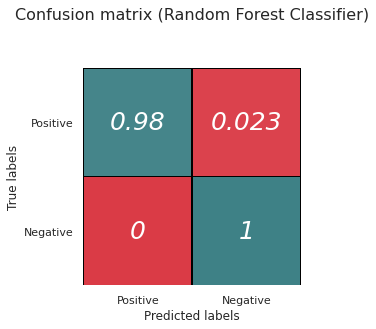

In [95]:
fig, axis1 = plt.subplots(nrows=1, ncols=1) 
plot_confusion_matrix(y_test, forest_pred,  ax=axis1, title='Confusion matrix (Random Forest Classifier)')

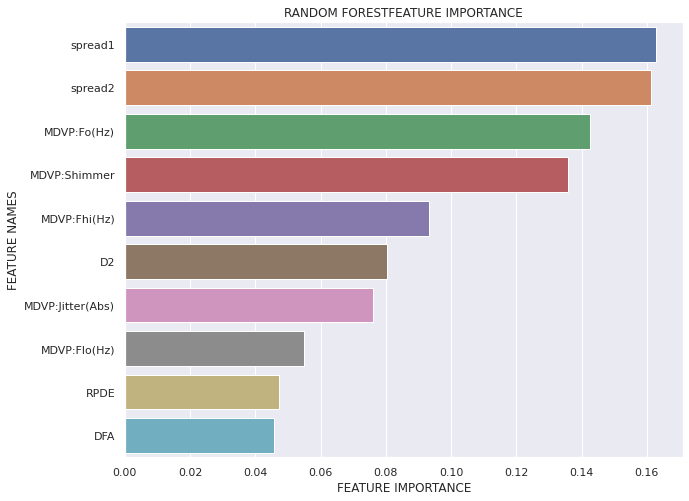

In [96]:
sns.set()
plot_feature_importance(forest.feature_importances_, X_resampled.columns, 'RANDOM FOREST')

<p>
  <span style="font-family: Candara, Lato, Candara, Verdana, Geneva, sans-serif;">
    <span style="font-size: 17px;">Hence, we can confirm that the most important features for the target prediction are
      <strong>spread1, MDVP:Fo(HZ), spread2
      </strong> along with somewhat important features MDVP:Shimmer, MDVP:Fhi(Hz), MDVP:Jitter(Abs) and D2, MDPV:Flo(Hz), DFA, RPDE are weak predictors
      <br>
    </span>
  </span>
</p>
<p>
  <span style="font-family: Candara, Lato, Candara, Verdana, Geneva, sans-serif;">
    <span style="font-size: 17px;">
      <br>
    </span>
  </span>
</p>


<h2><span style="font-family: Candara, Lato, Arial, Verdana; font-size: 22px;">Model Evaluation</span></h2>

In [97]:
results = pd.DataFrame(dict(models)).T.sort_values(by=['f1', 'accuracy'], ascending = [False, False])

In [98]:
results.set_index('name')

,f1,accuracy
name,,
Support Vector Classifier,1.000000,1.000000
Meta Classifier,1.000000,1.000000
Random Forest Classifier,0.989247,0.988764
Decision Tree Classifier,0.967033,0.966292
K Nearest Neighbors Classifier,0.966292,0.966292
XGBoost Classifier,0.958333,0.955056
Logistic Regression,0.848485,0.831461
Naive Bayes Classifier,0.796117,0.764045


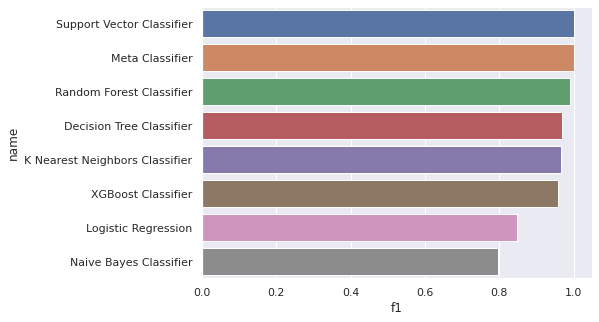

In [99]:
sns.set()
plt.figure(figsize=(7,5))
sns.barplot(x = "f1", y = "name", data = results)
plt.show()

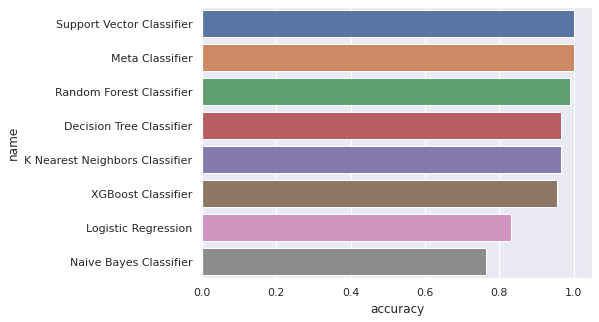

In [100]:
sns.set()
plt.figure(figsize=(7,5))
sns.barplot(x = "accuracy", y = "name", data = results)
plt.show()

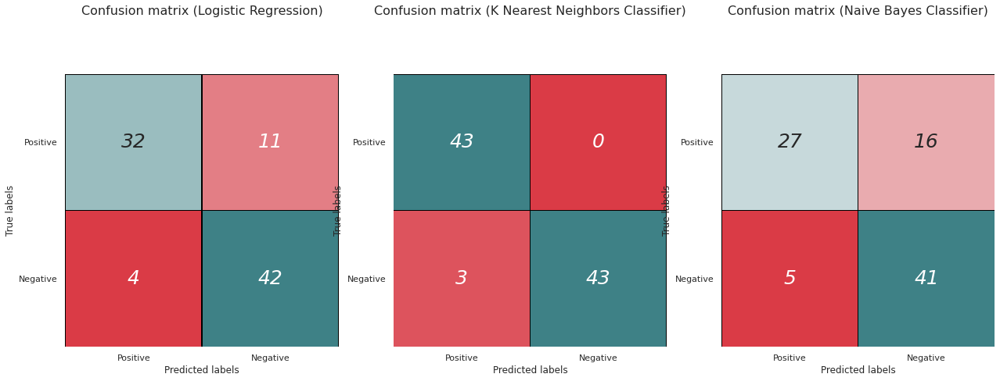

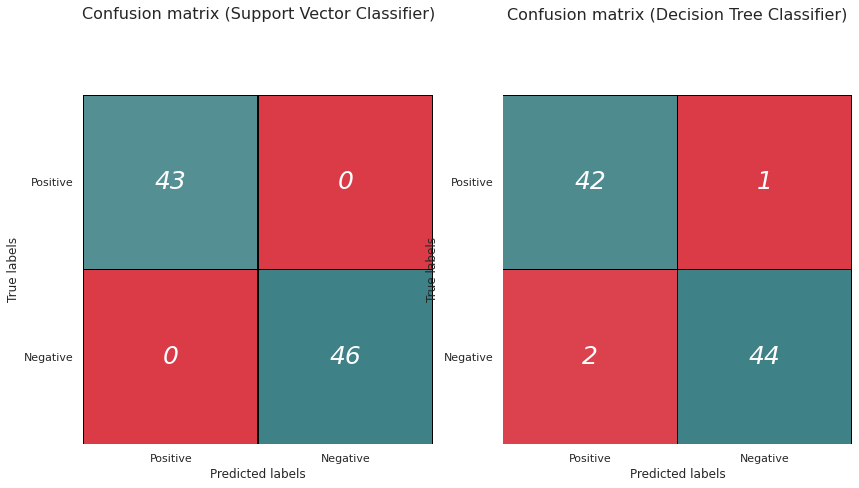

In [109]:
# confusion matrix of base models
sns.set()
fig=plt.figure(figsize=(16.5, 8.5))
plt.subplots_adjust(left=1, right=2)
ax=fig.add_subplot(1,3,1)
plot_confusion_matrix(y_test, lr_pred,  ax=ax, title='Confusion matrix (Logistic Regression)', normalized = False)
ax=fig.add_subplot(1,3,2)
plot_confusion_matrix(y_test, knn_pred,  ax=ax, title='Confusion matrix (K Nearest Neighbors Classifier)', normalized = False)
ax=fig.add_subplot(1,3,3)
plot_confusion_matrix(y_test, nb_pred,  ax=ax, title='Confusion matrix (Naive Bayes Classifier)', normalized = False)
plt.show()
fig=plt.figure(figsize=(16.5,8.5))
plt.subplots_adjust(left=1, right=2)
ax=fig.add_subplot(1,3,1)
plot_confusion_matrix(y_test, svc_pred,  ax=ax, title='Confusion matrix (Support Vector Classifier)', normalized = False)
ax=fig.add_subplot(1,3,2)
plot_confusion_matrix(y_test, dtree_pred,  ax=ax, title='Confusion matrix (Decision Tree Classifier)', normalized = False)
plt.show()

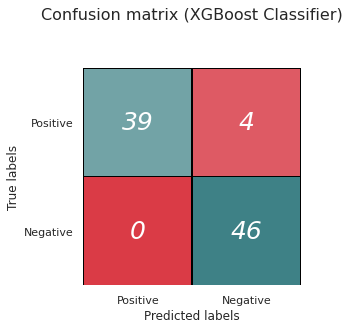

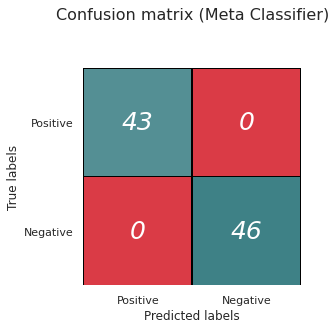

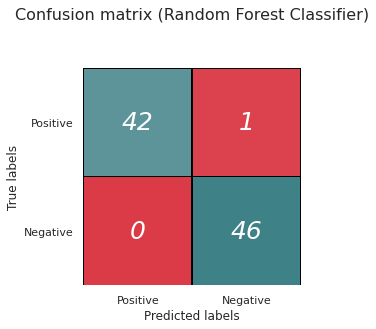

In [110]:
# ensemble models
fig, axis1 = plt.subplots(nrows=1, ncols=1)
plot_confusion_matrix(y_test, xgb_pred,  ax=axis1, title='Confusion matrix (XGBoost Classifier)', normalized = False)
fig, axis1 = plt.subplots(nrows=1, ncols=1)
plot_confusion_matrix(y_test, meta_pred,  ax=axis1, title='Confusion matrix (Meta Classifier)', normalized = False)
fig, axis1 = plt.subplots(nrows=1, ncols=1)
plot_confusion_matrix(y_test, forest_pred,  ax=axis1, title='Confusion matrix (Random Forest Classifier)', normalized = False)

<p>
  <span style="font-size: 17px; font-family: Candara, Candara, Verdana, Geneva, sans-serif;">
    Random Forest Classifier is an ensemble model which employs multiple decision trees to classify. So, it's not prone to overfitting and generally quite robust in classification tasks. XGBoost Classifier is a boosting ensemble model in which weak learners are trained sequentially so that each model tries to reduce the error made by the previous model.
    <br>
    Random Forest Classifier performs well on this dataset as it's able to learn from similar datapoints. i.e, Similar data points with similar values for the attributes tend to have similary target response. Also, XGBoost Classifier is able to learn. <br>However, one drawback of ensemble models is the requirement of more compute and trainng time and also an increased inference latency. This might not make them viable in a production environment where latency of predictions is critical.
  </span>
</p>

<p>
  <span style="font-size: 17px; font-family: Candara, Candara, Verdana, Geneva, sans-serif;">We have chosen the F1 Score as the metric to judge our models since we are concerned with Positive Class and the Classification Class is Imbalanced. So, Using F1 Score is a viable option to judge the models as it takes into consideration both False Positives and False Negatives while scoring.
    <br>
    Also, looking at the confusion matrices for all models we can see that the <strong>Meta Classifier and the Support Vector Classifier are the best models</strong>. 
    <br>Further, <strong>Meta Classifier</strong> is expected to generalize better than Support Vector Classifier on unseen data as it depends on many models and has reduced variance.
    <br>
  </span>
</p>